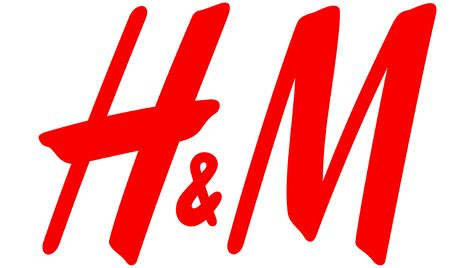

# Table of Contents

* [Exploratory Data Analysis & data preprocessing](#data)
    * [Loading data](#data)
    * [Exploring articles.csv](#articles)
        * [How is this data useful ?](#articles_use)
        * [What processing needed ?](#articles_processing)
    * [Exploring customers.csv](#customers)
        * [How is this data useful ?](#customers_use)
        * [What processing needed ?](#customers_processing)
    * [Exploring transactions_train.csv.csv](#transactions)
        * [How is this data useful ?](#transactions_use)
        * [What processing needed ?](#transactions_processing)
    * [Structure of data and link between datasets](#structure)
    
    
* [Recommendation system](#Recommendation)
    * [List and description of recommendation algorithms](#algos)
    
    
    
    feature engineering 

# Exploratory Data Analysis & data preprocessing

In [157]:
pip install pandasql

Note: you may need to restart the kernel to use updated packages.Collecting pandasql

  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for pandasql: filename=pandasql-0.7.3-py3-none-any.whl size=26784 sha256=6b960f4a52e5318405ee789f855a4ab6790e76f4fc9dc97dfd42c7e0ed8ab378
  Stored in directory: c:\users\amaur\appdata\local\pip\cache\wheels\63\e8\ec\75b1df467ecf57b6ececb32cb16f4e86697cbfe55cb0c51f07
Successfully built pandasql


In [3]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
from pandasql import sqldf

### Loading data <a class="anchor" id="data"></a>

In [105]:
# articles = pd.read_csv('./Data/articles.csv')

raw_articles = pd.read_csv('./Data/articles.csv', dtype={'article_id': 'str','customer_id':'str'})
articles=raw_articles.copy()

In [106]:
raw_customers = pd.read_csv('./Data/customers.csv')
customers=raw_customers.copy()

In [4]:
raw_transactions=pd.read_csv('./Data/transactions_train.csv', dtype={'article_id': 'str','customer_id':'str'})
transactions=raw_transactions.copy()

## Explore articles.csv  <a class="anchor" id="articles"></a>

- **article_id :** A unique identifier of every article.
- **product_code, prod_name :** A unique identifier of every product and its name (not the same).
- **product_type, product_type_name :** The group of product_code and its name
- **graphical_appearance_no, graphical_appearance_name :** The group of graphics and its name
- **colour_group_code, colour_group_name :** The group of color and its name
- **graphical_appearance_no, graphical_appearance_name :** The group of graphics and its name
- **perceived_colour_value_id, perceived_colour_value_name, perceived_colour_master_id, perceived_colour_master_name :** The added color info
- **department_no, department_name:** A unique identifier of every dep and its name
- **index_code, index_name:** A unique identifier of every index and its name
- **index_group_no, index_group_name:** A group of indices and its name
- **section_no, section_name:** A unique identifier of every section and its name
- **garment_group_no, garment_group_name:** A unique identifier of every garment and its name
- **detail_desc:**  Details


<font color='red'> we should have a match always between code/type and name </font>


<font color='red'> what is the difference between article_id and product code/, name ?  </font>


<font color='red'> maybe images can help us correct for categories   </font>

In [26]:
articles.head()

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,department_name,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,detail_desc
0,0108775015,108775,Strap top,253,Vest top,Garment Upper body,1010016,Solid,9,Black,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.
1,0108775044,108775,Strap top,253,Vest top,Garment Upper body,1010016,Solid,10,White,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.
2,0108775051,108775,Strap top (1),253,Vest top,Garment Upper body,1010017,Stripe,11,Off White,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.
3,0110065001,110065,OP T-shirt (Idro),306,Bra,Underwear,1010016,Solid,9,Black,...,Clean Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Microfibre T-shirt bra with underwired, moulde..."
4,0110065002,110065,OP T-shirt (Idro),306,Bra,Underwear,1010016,Solid,10,White,...,Clean Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Microfibre T-shirt bra with underwired, moulde..."


In [6]:
articles.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 105542 entries, 0 to 105541
Data columns (total 25 columns):
 #   Column                        Non-Null Count   Dtype 
---  ------                        --------------   ----- 
 0   article_id                    105542 non-null  int64 
 1   product_code                  105542 non-null  int64 
 2   prod_name                     105542 non-null  object
 3   product_type_no               105542 non-null  int64 
 4   product_type_name             105542 non-null  object
 5   product_group_name            105542 non-null  object
 6   graphical_appearance_no       105542 non-null  int64 
 7   graphical_appearance_name     105542 non-null  object
 8   colour_group_code             105542 non-null  int64 
 9   colour_group_name             105542 non-null  object
 10  perceived_colour_value_id     105542 non-null  int64 
 11  perceived_colour_value_name   105542 non-null  object
 12  perceived_colour_master_id    105542 non-null  int64 
 13 

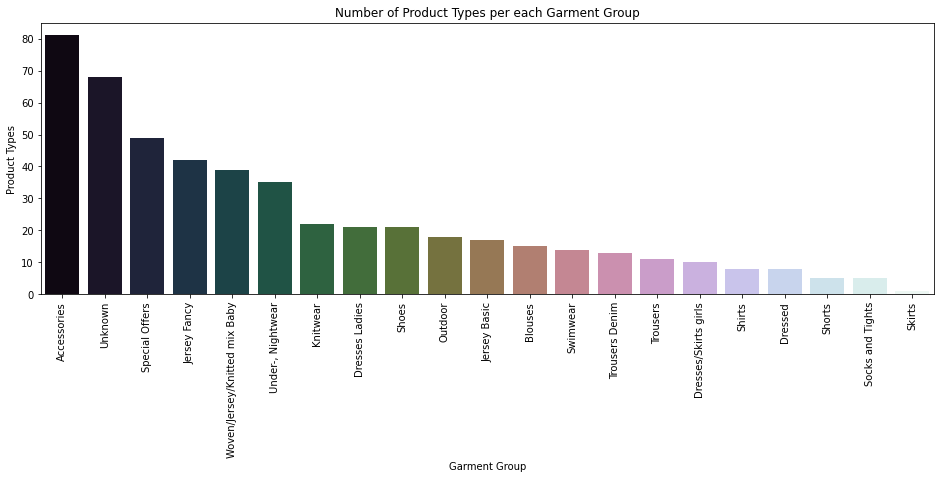

In [124]:
temp = articles.groupby(["garment_group_name"])["product_type_name"].nunique()
df = pd.DataFrame({"Garment Group": temp.index, "Product Types": temp.values})
df = df.sort_values(["Product Types"], ascending=False)
plt.figure(figsize=(16, 5))
plt.title("Number of Product Types per each Garment Group")
s = sns.barplot(x="Garment Group", y="Product Types", data=df, palette="cubehelix")
s.set_xticklabels(s.get_xticklabels(), rotation=90)
locs, labels = plt.xticks()
plt.show()

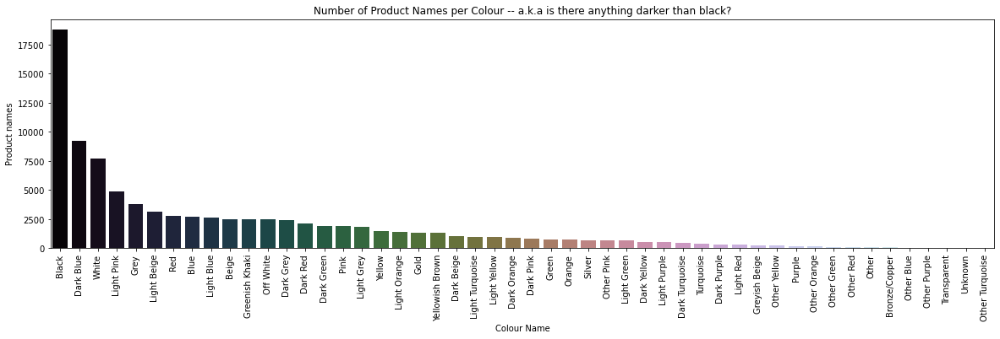

In [125]:
temp = articles.groupby(["colour_group_name"])["prod_name"].nunique()
df = pd.DataFrame({"Colour Name": temp.index, "Product names": temp.values})
df = df.sort_values(["Product names"], ascending=False)
plt.figure(figsize=(20, 5))
plt.title(
    "Number of Product Names per Colour -- a.k.a is there anything darker than black?"
)
s = sns.barplot(x="Colour Name", y="Product names", data=df, palette="cubehelix")
s.set_xticklabels(s.get_xticklabels(), rotation=90)
locs, labels = plt.xticks()
plt.show()

In [126]:
articles.groupby(["index_group_name", "index_group_no", "index_name", "index_code"])[
    "article_id"
].count()

index_group_name  index_group_no  index_name                      index_code
Baby/Children     4               Baby Sizes 50-98                G              8875
                                  Children Accessories, Swimwear  J              4615
                                  Children Sizes 134-170          I              9214
                                  Children Sizes 92-140           H             12007
Divided           2               Divided                         D             15149
Ladieswear        1               Ladies Accessories              C              6961
                                  Ladieswear                      A             26001
                                  Lingeries/Tights                B              6775
Menswear          3               Menswear                        F             12553
Sport             26              Sport                           S              3392
Name: article_id, dtype: int64

So Baby/Children and Women have sub-categories, I don't see that would help us with modelling at this stage. The index code+group, could easily be encoded to uniquely identify each group and name.

In [123]:
articles.groupby(['department_name','department_no']).count()['article_id']

department_name                           department_no
AK Bottoms                                1744               90
AK Dresses & Outdoor                      5626               87
AK Other                                  4030               33
AK Tops Jersey & Woven                    4020               42
AK Tops Knitwear                          5627               28
Accessories                               3510                7
                                          3941               57
                                          7530               51
                                          9985              579
Accessories Boys                          8564               10
Accessories Other                         3931                1
Asia Assortment                           7912              101
Baby Boy Jersey Fancy                     6545              872
Baby Boy Knitwear                         6546              140
Baby Boy Local Relevance                  2932  

In [137]:
temp=articles.groupby(['department_no','department_name']).count()['article_id']

In [141]:
temp=temp.reset_index()

In [142]:
temp.department_name.value_counts()

Knitwear                                    11
Trouser                                      7
Jersey                                       5
Shorts                                       5
Shirt                                        4
Accessories                                  4
Jersey Fancy                                 3
Blouse                                       3
Dress                                        3
OL Extended Sizes                            2
Jersey License                               2
Jersey Basic                                 2
Outwear                                      2
Woven bottoms                                2
Bags                                         2
Belts                                        2
Loungewear                                   2
Small Accessories                            2
Swimwear                                     2
EQ & Special Collections                     2
Blazer                                       2
Skirt        

In [153]:
skirts=articles[articles['department_name']=='Skirts'][['article_id','detail_desc','department_name','department_no']]
skirts_head=skirts.head(40)

Est-ce que les différences de department_name se retrouve au niveau des dates ? 

In [ ]:
full_transactions_skirts=skirts_head.merge(transactions, on='article_id')

In [162]:
merge = sqldf("""SELECT *
            FROM articles a
            join transactions t on a.articles=t.articles
            """)

KeyboardInterrupt: 

In [11]:
transactions[transactions['article_id'] == '0108775015']

,t_dat,customer_id,article_id,price,sales_channel_id
1042,2018-09-20,05ed96931b707698bc94aa53766d44686ae5ccbbc99dfb...,0108775015,0.008458,1
1043,2018-09-20,05ed96931b707698bc94aa53766d44686ae5ccbbc99dfb...,0108775015,0.008458,1
1957,2018-09-20,0aaa9683d5f45b85d0f9a81e2f4d4ef774fed43339fb75...,0108775015,0.008068,2
6104,2018-09-20,20ccafd82d923baecf1fb8705d459e243c8ca9c74ee24e...,0108775015,0.008458,1
6208,2018-09-20,2135790e6b63d10b59f9d8b84a58e24328b0f5ed3a48f1...,0108775015,0.008458,1
...,...,...,...,...,...
26700596,2020-06-02,75cc8fd668a8816f6a0daaf4f56b745341a34bb86bc36d...,0108775015,0.003729,1
26758874,2020-06-03,a1c8d3a99f3a4fe6f5a517b309eff3e2e6a4f2c53e8318...,0108775015,0.008458,2
29270530,2020-07-20,f6ac2f20807ae268f450cab20410c2bec88e06c0e827ed...,0108775015,0.005068,1
29274957,2020-07-21,12600404ef642873ccc3902e2f26a000d087972775e5d1...,0108775015,0.004390,1


In [ ]:
merge.head(10)

In [ ]:
full_transactions_skirts.groupby(['department_name','t_dat']).count()

Ici on a peut etre du ménage à faire avec des département name qui sont les meme : à regrouper sous un meme department_no ? Checker avec les photos ? Faire 3 à 4 catégories: adult,young,kid,baby ? 

In [7]:
pd.options.display.max_rows = None
articles.groupby(['product_group_name', 'product_type_name']).count()['article_id']

product_group_name     product_type_name       
Accessories            Accessories set                 7
                       Alice band                      6
                       Baby Bib                        3
                       Bag                          1280
                       Beanie                         56
                       Belt                          458
                       Bracelet                      180
                       Braces                          3
                       Bucket hat                      7
                       Cap                            13
                       Cap/peaked                    573
                       Dog Wear                       20
                       Earring                      1159
                       Earrings                       11
                       Eyeglasses                      2
                       Felt hat                       10
                       Giftbox          

## Explore customers.csv  <a class="anchor" id="customers"></a>

- **customer_id :** A unique identifier of every customer
- **FN (Fashion News ?):** 1 or missed
- **Active :** 1 or missed
- **club_member_status :** Status in club
- **fashion_news_frequency :** How often H&M may send news to customer
- **age :** The current age
- **postal_code :** Postal code of customer

What does FN, Active, club_membership and fashion_news_frequency mean for the **customer in terms of engagement towards the brand ?**

In [8]:
customers.head()

,customer_id,FN,Active,club_member_status,fashion_news_frequency,age,postal_code
0,00000dbacae5abe5e23885899a1fa44253a17956c6d1c3...,NaN,NaN,ACTIVE,NONE,49.0,52043ee2162cf5aa7ee79974281641c6f11a68d276429a...
1,0000423b00ade91418cceaf3b26c6af3dd342b51fd051e...,NaN,NaN,ACTIVE,NONE,25.0,2973abc54daa8a5f8ccfe9362140c63247c5eee03f1d93...
2,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,NaN,NaN,ACTIVE,NONE,24.0,64f17e6a330a85798e4998f62d0930d14db8db1c054af6...
3,00005ca1c9ed5f5146b52ac8639a40ca9d57aeff4d1bd2...,NaN,NaN,ACTIVE,NONE,54.0,5d36574f52495e81f019b680c843c443bd343d5ca5b1c2...
4,00006413d8573cd20ed7128e53b7b13819fe5cfc2d801f...,1.0,1.0,ACTIVE,Regularly,52.0,25fa5ddee9aac01b35208d01736e57942317d756b32ddd...


### customer_id

#### Missing values ? 

In [9]:
customers['customer_id'].isna().sum()

0

No missing value, nothing to do here

### FN

#### Missing vlaues ? 

In [10]:
customers['FN'].isna().sum()

895050

##### Meaning

Probably means 'Fashion news' in which case a NaN value would mean a fashion news frequency of never = NaN 

In [11]:
customers['FN'] = customers['FN'].fillna(0)
customers['Active'] = customers['Active'].fillna(0)
customers.groupby(['FN','fashion_news_frequency'])['customer_id','Active','club_member_status'].count()

C:\Users\amaur\AppData\Local\Temp\ipykernel_71024\176051249.py:3: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  customers.groupby(['FN','fashion_news_frequency'])['customer_id','Active','club_member_status'].count()


customer_id  Active  club_member_status
FN  fashion_news_frequency                                         
0.0 Monthly                          13      13                  13
    NONE                         876922  876922              873223
    Regularly                      2106    2106                2099
1.0 Monthly                         829     829                 824
    NONE                            789     789                 783
    None                              2       2                   2
    Regularly                    475310  475310              475000

In [19]:
customers_agg_df=customers.groupby(['FN','fashion_news_frequency']).agg(
    num_customer_id=('customer_id','count'),
    num_active=("Active", "sum"),
)
customers_agg_df

num_customer_id  num_active
FN  fashion_news_frequency                             
0.0 Monthly                              13         0.0
    NONE                             876922         0.0
    Regularly                          2106         0.0
1.0 Monthly                             829       798.0
    NONE                                789       499.0
    None                                  2         1.0
    Regularly                        475310    463106.0

<font color='red'> One interpretation is that some FN values are mismatched: all 1's should be monthly or regularly and all 0 should be NONE. ==> Comment on valide cette hypothèse ?  </font>

## FN is if a customer get Fashion News newsletter, Active is if the customer is active for communication, sales channel id, 2 is online and 1 store.

Probably, FN is an abbreviation of "fashion news" and highly correlates with "fashion news frequency".
It seems to me that "Active" tells us something about fashion news delivering status.


The latter is because there is no record such that FN = n/a & Active = 1.

### Active

#### Missing vlaues ? 

In [16]:
customers['Active'].isna().sum()

0

In [17]:
customers['Active'].value_counts()

0.0    907576
1.0    464404
Name: Active, dtype: int64

### club_member_status

What does pre_create means ? 

### fashion_news_frequency

<AxesSubplot:>

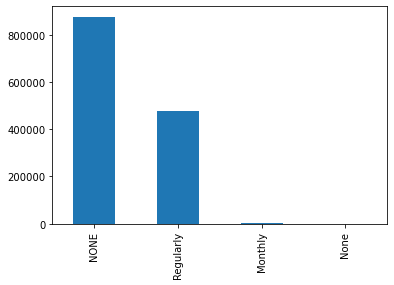

In [127]:
customers.fashion_news_frequency.value_counts().plot(kind="bar")

In [ ]:
customers['fashion_news_frequency'].value_counts()

In [ ]:
customers['fashion_news_frequency']=customers['fashion_news_frequency'].replace('None', 'NONE')
customers['fashion_news_frequency'].value_counts()

In [ ]:
customers['fashion_news_frequency'].isna().sum()

##### Que fait-on des missing values pour fashion_news_frequency ?

In [ ]:
customers['club_member_status'].value_counts()

In [ ]:
customers['club_member_status'].isna().sum()

In [ ]:
na_member_status=customers[customers['club_member_status'].isna()]
na_member_status

For those 6062 customers question is: are they ACTIVE,PRE-CREATE,LEFT CLUB or Not Member ?? (en fonction du nombre de purchases ? de la fréquence ? est-ce que c'est marqué dans la présentation des données ? ) 

In [128]:
customers.postal_code.value_counts()

2c29ae653a9282cce4151bd87643c907644e09541abc28ae87dea0d1f6603b1c    120303
cc4ed85e30f4977dae47662ddc468cd2eec11472de6fac5ec985080fd92243c8       261
714976379549eb90aae4a71bca6c7402cc646ae7c40f6c1cb91d4b5a18623fc1       159
7c1fa3b0ec1d37ce2c3f34f63bd792f3b4494f324b6be5d1e4ba6a75456b96a7       157
5b7eb31eabebd3277de632b82267286d847fd5d44287ee150bb4206b48439145       156
1f5bd429acc88fbbf24de844a59e438704aa8761bc7b99fd977cad297c50b74c       154
9d5787501bf1c77592156ba51eab13f4a2670c807686431a9e22a69090b02358       141
a1959a16bf167858c93a66ec2a330644512b25fb10f97eee2058549885af4dbd       138
087a46b65170845b4a55226ff1eb748ce7843d4b637cbe17f6bfbd1e645d2ffb       134
4d22901a97bd952bb92cdd31b38c39b41dd3250a735cabdfac1503eb405b807d       132
45dc52765eb24eb8bc8a4a40a682d5e430aed58a9aba44e7f67d9516e54ba0d1       113
2790324c84cdb8ba471be2a199cfb5103bbe1ab10883a0312b6928b05d6ee6c4       109
262cfc24e32aec2c7adc42cf50af7a412127aa064e0269d5723477d5631dcccb       107
e7bcbb41a62610d1067e0effb

### age

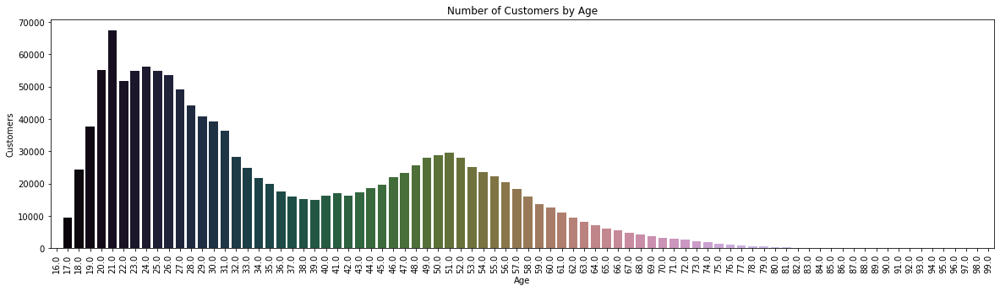

In [129]:
temp = customers.groupby(["age"])["customer_id"].count()
df = pd.DataFrame({"Age": temp.index, "Customers": temp.values})
df = df.sort_values(["Age"], ascending=False)
plt.figure(figsize=(20, 5))
plt.title(f"Number of Customers by Age")
s = sns.barplot(x="Age", y="Customers", data=df, palette="cubehelix")
s.set_xticklabels(s.get_xticklabels(), rotation=90)
locs, labels = plt.xticks()
plt.show()

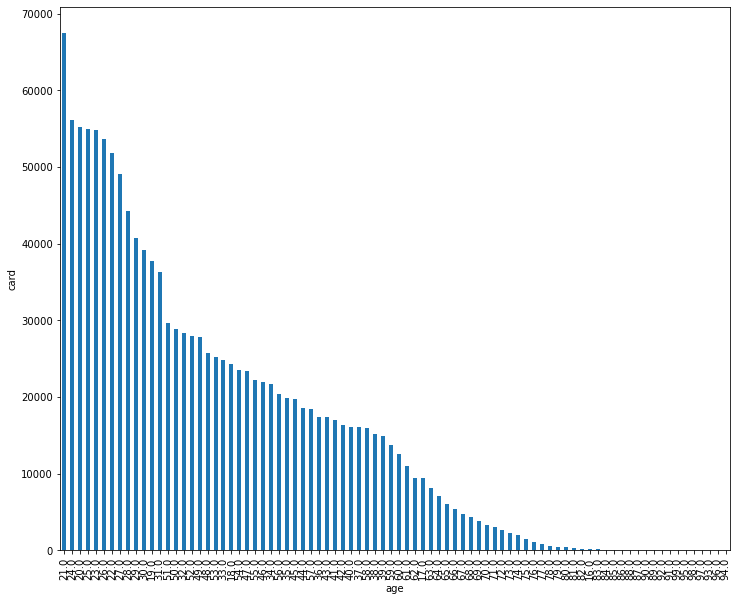

In [130]:
fig, axs = plt.subplots(figsize=(12, 4))

customers['age'].value_counts().plot.hist(figsize=(12, 10),bins=10)
customers['age'].value_counts().plot.bar(figsize=(12, 10))

axs.set_ylabel("card")
axs.set_xlabel("age")

fig.savefig("no2_concentrations.png")

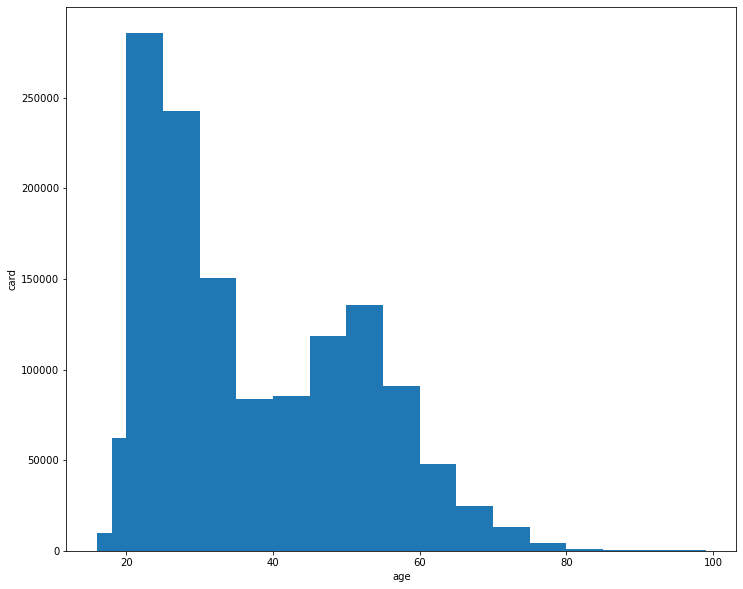

In [131]:
fig, axs = plt.subplots(figsize=(12, 4))

customers['age'].plot.hist(figsize=(12, 10),bins = [customers['age'].min(),18,20, 25,30,35,40,45,50,55,60,65,70,75,80,85,customers['age'].max()])
axs.set_ylabel("card")
axs.set_xlabel("age")

fig.savefig("no2_concentrations.png")

In [ ]:
isna=customers[customers['age'].isna()==True]
isna

Un certain nombre de customer n'ont pas renseigné leur age qui peut etre une donnée importante pour prédire les comportements d'achat. ==> **besoin de rensigner cette info (moyenne, ou median, KNN MICE)**

### What's interecting and how to use the data ?  <a class="anchor" id="customers_use"></a> 

### What data processing are needed ? <a class="anchor" id="customers_processing"></a> 

## Explore transactions.csv  <a class="anchor" id="transactions"></a>

- **t_dat :** A unique identifier of every customer
- **customer_id :** A unique identifier of every customer (in customers table)
- **article_id :** A unique identifier of every article (in articles table)
- **price :** Price of purchase
- **sales_channel_id :** 1 or 2

In [98]:
transactions.head(15)

,t_dat,customer_id,article_id,price,sales_channel_id
0,2018-09-20,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,0663713001,0.050831,2
1,2018-09-20,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,0541518023,0.030492,2
2,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,0505221004,0.015237,2
3,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,0685687003,0.016932,2
4,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,0685687004,0.016932,2
5,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,0685687001,0.016932,2
6,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,0505221001,0.020322,2
7,2018-09-20,00083cda041544b2fbb0e0d2905ad17da7cf1007526fb4...,0688873012,0.030492,1
8,2018-09-20,00083cda041544b2fbb0e0d2905ad17da7cf1007526fb4...,0501323011,0.053373,1
9,2018-09-20,00083cda041544b2fbb0e0d2905ad17da7cf1007526fb4...,0598859003,0.045746,2


In [99]:
transactions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31788324 entries, 0 to 31788323
Data columns (total 5 columns):
 #   Column            Dtype  
---  ------            -----  
 0   t_dat             object 
 1   customer_id       object 
 2   article_id        object 
 3   price             float64
 4   sales_channel_id  int64  
dtypes: float64(1), int64(1), object(3)
memory usage: 1.2+ GB


In [100]:
transactions['sales_channel_id']=transactions['sales_channel_id'].replace(1,'online')
transactions['sales_channel_id']=transactions['sales_channel_id'].replace(2,'offline')
# transactions['sales_channel_id'].head(15)

In [102]:
processed_transactions=transactions.copy()

In [133]:
temp1 = transactions.query("article_id == '0706016001'")[["t_dat", "price"]]
temp2 = transactions.query("article_id == '0706016002'")[["t_dat", "price"]]
temp3 = transactions.query("article_id == '0372860001'")[["t_dat", "price"]]
temp4 = transactions.query("article_id == '0610776002'")[["t_dat", "price"]]

KeyboardInterrupt: 

In [ ]:
fig, ax = plt.subplots(figsize=(16, 9))
try:
    sns.regplot(x="t_dat", y="price", data=temp1, ax=ax)
except TypeError:
    pass

In [ ]:
fig, ax = plt.subplots(figsize=(16, 9))
try:
    sns.regplot(x="t_dat", y="price", data=temp2, ax=ax)
except TypeError:
    pass

In [ ]:
fig, ax = plt.subplots(figsize=(16, 9))
try:
    sns.regplot(x="t_dat", y="price", data=temp4, ax=ax)
except TypeError:
    pass

So there are 6 distinct "price bands" it would seem. I was expecting to be some clear fluctuations throughout the year year because of sales. There is also a lot of noise, maybe there is a sale or someone has a discount code? Or something like that. The 'bands' in the price,at least for the ones I have looked out seem fairly evenly spaced within the article_id. Hmmmm. Someone else has probably figured this out - someone who works for/with online sales

In [ ]:
fig, ax = plt.subplots(figsize=(16, 9))
sns.kdeplot(transactions.price, ax=ax)

In [ ]:
transactions_byid = transactions.groupby("customer_id").count()
customer_purchases = transactions_byid.sort_values(by="price", ascending=False)["price"]

In [ ]:
customer_purchases[:300]

In [ ]:
plt.figure(figsize=(16, 9))
plt.plot(list(range(300_000)), customer_purchases[:300_000])
plt.title("Purchases per customer")

### What's interecting and how to use the data ?  <a class="anchor" id="transactions_use"></a> 

### What data processing are needed ? <a class="anchor" id="transactions_processing"></a> 

## Structure of data and link between datasets <a class="anchor" id="structure"></a>

Transactions links the article **article_id** bought by customer **customer_id**		

# Recommendation system <a class="anchor" id="Recommendations"></a> 

## List and description of recommendation algorithms <a class="anchor" id="algos"></a>

In [22]:
sample_submission=pd.read_csv('./Data/sample_submission.csv')

In [23]:
sample_submission.head(10)

,customer_id,prediction
0,00000dbacae5abe5e23885899a1fa44253a17956c6d1c3...,0706016001 0706016002 0372860001 0610776002 07...
1,0000423b00ade91418cceaf3b26c6af3dd342b51fd051e...,0706016001 0706016002 0372860001 0610776002 07...
2,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,0706016001 0706016002 0372860001 0610776002 07...
3,00005ca1c9ed5f5146b52ac8639a40ca9d57aeff4d1bd2...,0706016001 0706016002 0372860001 0610776002 07...
4,00006413d8573cd20ed7128e53b7b13819fe5cfc2d801f...,0706016001 0706016002 0372860001 0610776002 07...
5,000064249685c11552da43ef22a5030f35a147f723d5b0...,0706016001 0706016002 0372860001 0610776002 07...
6,0000757967448a6cb83efb3ea7a3fb9d418ac7adf2379d...,0706016001 0706016002 0372860001 0610776002 07...
7,00007d2de826758b65a93dd24ce629ed66842531df6699...,0706016001 0706016002 0372860001 0610776002 07...
8,00007e8d4e54114b5b2a9b51586325a8d0fa74ea23ef77...,0706016001 0706016002 0372860001 0610776002 07...
9,00008469a21b50b3d147c97135e25b4201a8c58997f787...,0706016001 0706016002 0372860001 0610776002 07...


### To simplify the discussion I propose to call the set of articles that a customer bought on a given date a basket. And then this problem can be really summarized as predict next basket.

General approach towards problems like this could be as follows. At least mine will be.

### 1. For each customer generate candidates that they can buy.
These candidates are your negative and positive examples. I'm saying this because someone on the forum asked where are the negative observations. And the answer is you generate them.

The strategies to generate those candidates are probably the most important aspect of this competition. The strategies can be based on:

item to item similarities between customer previous baskets - so image similarity is not out of the question as somebody suggested
user based collaborative filtering
last baskets (with the hope that the user will buy them again)
model based predictions with customers without the transaction history
etc
Coming up with different strategies is a fun challenge :). I cannot imagine that a winning solution will be based on a closed form model representing one strategy. Once you have all the different strategies ready for each customer then it is time to create a huge table with columns like these:

observation_date - the date for which you are making predictions - submission should be based on all the data before 2020-09-22 (my birthday btw).
customer_id
article_id
bought in the next week (this is your label)
customer static attributes
customer dynamic attributes
article static attributes
article dynamic attributes (maybe item popularity and such)
whether the article exist in the strategies and which ones
strategy score (whatever it is)
many other features that relate the item to the user
Once you have a table like this it all becomes very familiar. There were many competitions involving click through predictions. They have almost an identical structure the only difference is the source of observations.



### 2. Build a ranking model that ranks the items within Customer
Ranking is a different problem than classification but in general classification models can be used as well. My favourite ranking model is LightGBM (we used it in RecSys 2019) https://lightgbm.readthedocs.io/en/latest/pythonapi/lightgbm.LGBMRanker.html.

The customer id can be treated as a query in ranking model because you are interested in optimizing the scores at a customer level.

General tips
Sample the data as much as possible - most of the competition you should spend validating your features on the sample. Increase the sample you are using when you are no longer seeing the correlation between local validation and the leaderboard.

Test different ideas quickly. Fast local validation is key here because you must do as much experiments as possible.

We are creating 0.1%, 1%, and 5% samples of the original dataset. Keeping the related articles and customers.

In [ ]:
for sample_repr, sample in [("01", 0.001), ("1", 0.01), ("5", 0.05)]:
    print(sample)
    customers_sample = customers.sample(int(customers.shape[0]*sample), replace=False)
    customers_sample_ids = set(customers_sample["customer_id"])
    transactions_sample = transactions[transactions["customer_id"].isin(customers_sample_ids)]
    articles_sample_ids = set(transactions_sample["article_id"])
    articles_sample = articles[articles["article_id"].isin(articles_sample_ids)]
    customers_sample.to_csv(f"customers_sample{sample_repr}.csv.gz", index=False)
    transactions_sample.to_csv(f"transactions_train_sample{sample_repr}.csv.gz", index=False)
    articles_sample.to_csv(f"articles_train_sample{sample_repr}.csv.gz", index=False)

https://www.kaggle.com/c/h-and-m-personalized-fashion-recommendations/discussion/307001

https://www.kaggle.com/c/h-and-m-personalized-fashion-recommendations/discussion/305952#1699535

<font color='red'>There are 3 parts of the task </font>
- Which Customers will buy?
- Which Articles will be sold?
- Which Customers will buy which articles?


### available stock

Actually what is missing is the 'available stock' since we don't know that stock, its impossible your site will show the stock that is not avaiable, and you suggest we forecast what they want to purchase, you will endup with a wrong forecast of the historical stock. Or you we should make a guess about the available stock as the last 6month purchases

### Already bought and new items

@fridarimark - I have a question I hope I didn't miss it anywhere. Should we consider predicting items that a user has NOT purchased before? Or both items purchased and not purchased? I feel typically the idea is to show the user new content but they can certainly re-purchase the same item 🤔

<font color='red'>For this competition we don't require that it should be new content that you provide as recommendations. Therefore you may recommend items that the customer already has bought.</font>

### article_ids as string 
Just a quick tip that I learned the hard way. I just made a couple submissions and was really perplexed at why they were scoring zero when I suspected there should have been some type of score. Turns out that you need to load in the article_id as a string str otherwise when you try and submit the string version the zeros are missing from the beginning of the string. Here is a quick snippet that can help that

data = pd.read_csv(
    '/kaggle/input/h-and-m-personalized-fashion-recommendations/transactions_train.csv',

    # Make sure article_id is being loading in as a string
    dtype={'article_id': str}
)

### How To Setup Local CrossValidation

The first step in every Kaggle competition is to build a reliable local validation scheme. Then we use our local validation score to evaluate experiment ideas and/or tune hyperparameters.

Train Data
The last day in the transaction dataframe is 2020-09-22. The public LB contains 1 week of transactions after this date. <font color='red'>Therefore to create a local validation that mimics Kaggle's train test relationship, we can train on all transactions before 2020-9-15. And validate on the last week in train data.</font>

train = pd.read_csv('transactions_train.csv')
train.t_dat = pd.to_datetime( train.t_dat )
train = train.loc[ train.t_dat <= pd.to_datetime('2020-09-15') ]
Valid Data
The code below will create a dataframe with only the customers who made purchases during the last week of train (which are the only ones that affect competition metric). It formats the predictions as strings like sample_submission.csv

valid = pd.read_csv('transactions_train.csv')
valid.t_dat = pd.to_datetime( train.t_dat )
valid = valid.loc[ train.t_dat >= pd.to_datetime('2020-09-16') ]
valid = valid.groupby('customer_id').article_id.apply(list).reset_index()
valid = valid.rename({'article_id':'prediction'},axis=1)
valid['prediction'] =\
    valid.prediction.apply(lambda x: ' '.join(['0'+str(k) for k in x]))
Compute Validation Score mAP
To compute your validation score, use the train dataframe above (which does not contain the validation dates) and then make predictions for every customer in sample_submission.csv. Create a column of prediction strings just like you would when submitting to Kaggle and save as submission.csv (to be used below).

Important x2
Once you have your submission.csv file (made by using train dataframe above which excludes last of train data), run the code below. Important x1, we must execute the second line below. It guarantees that your submission and valid dataframes are in the same row order. Furthermore it removes all customers who do not make predictions during validation period because these customers do not affect metric score. Important x1, remember to write your article_ids with a prefix of zero in your dataframe predictionstrings otherwise your validation and LB score will be 0.

sub = pd.read_csv('submission.csv')
sub = sub.set_index('customer_id').loc[valid.customer_id].reset_index()
mapk( valid.prediction.str.split(), sub.prediction.str.split(), k=12)
MapK Function
The MapK Function can be found on Kaggle's GitHub here or in Kaerururu's notebook here.

CV LB Agreement
Using the code above, the best public notebook here has validation score 0.023 and LB 0.020. If we combine my notebook here with that notebook, then the validation score improves to 0.024 and LB improves to 0.021 here. So it appears when validation score improves then LB improves.

3 Folds
To have a more reliable validation, we can use 3 or more folds and average the results. When doing 3 folds, the best public notebook here achieves 0.023, 0.021, 0.021 on folds 0,1,2 respectively and therefore achieves average 3-fold validation score of 0.022 which matches its LB score!

Fold 0 - train <= '2020-09-15', valid >= '2020-09-16'
Fold 1 - train <= '2020-09-08', (valid >= '2020-09-09')&(valid <= '2020-09-15')
Fold 2 - train <= '2020-09-01', (valid >= '2020-09-02')&(valid <= '2020-09-08')

https://www.kaggle.com/c/h-and-m-personalized-fashion-recommendations/discussion/305998

### Don't get yourself fooled. This is not similarity problem.

I see a lot of posts saying about so-called "similar" competitions and most of them reference matching tasks whereas this is recommender system task.

Does this mean that solutions based on similarities would not work? No.
But then what is the difference? Glad you asked.
While finding items similar to those that customer has already bought might be a solution it still lacks a valuable piece of information - similarity between customers themselves. Thus if customer C1 bought items M1, M2 and M3 and customer C2 bought items M1, M2 and M4 we can say that this customers preferences are similar and we can recommend item M4 to customer C1 and item M3 to customer C2.
So how do we find this kind of similarities between customers? Solution is called collaborative filtering.
One (of the oldest) implementations is matrix factorization.

**<font color="red">Suggests doing both item-based and user based recommendation</font>**

### Competition metric (MAP) code

def pandas_average_precision(
    data_true: pd.Series,
    data_predicted: pd.Series,
    k: int,
    norm: bool = True, 
) -> float:
    """

    :param data_true: items that were actually purchased by user
    :param data_predicted: items we recommended to user
    :param k: number of candidates (predictions)
    :param norm: nomalization flag
    """
    if len(data_true)==0:
        raise ValueError('data_true is empty')

    # convert to df so we can use `apply`
    eval_df = pd.DataFrame({"true": data_true, "predicted": data_predicted})

    # replace na predictions with empty list
    eval_df["predicted"] = eval_df["predicted"].apply(
        lambda x: x if isinstance(x, list) else []
    )

    # getting the counts of true/predicted
    eval_df["n_items_true"] = eval_df["true"].apply(len)
    eval_df["n_items_predicted"] = eval_df["predicted"].apply(
        lambda x: min(len(x), k)
    )

    # ignore zero true or predicted
    non_zero_filter = (eval_df["n_items_true"] > 0) & (eval_df["n_items_predicted"] > 0)
    eval_df = eval_df[non_zero_filter].copy()

    def row_precision(items_true, items_predicted, n_items_predicted, n_items_true, norm=norm):
        n_correct_items = 0
        precision = 0.0

        for item_idx in range(n_items_predicted):
            if items_predicted[item_idx] in items_true:
                n_correct_items += 1
                precision += n_correct_items / (item_idx + 1)

        if norm:
            return precision / min(n_items_true, k)
        else:
            return precision / k

    eval_df["row_precision"] = eval_df.apply(
        lambda x: row_precision(
            x["true"], x["predicted"], x["n_items_predicted"], x["n_items_true"]
        ), axis=1
    )

    return eval_df["row_precision"].sum() / len(data_true)

### Recommender systems - Evaluation hell

Keep in mind that the last big Recsys competition gave us Matrix Factorization :D
I wanted to take the opportunity and tickle your minds about how to properly evaluate Recommender systems, both in training and testing.

A well-known issue in recommender systems is the way the data is collected. In a perfect supervised learning setting, we make sure that the data is balanced, labels are correct, points are iid, etc… In Recsys, data is generated by users and this throws most traditional Machine Learning assumptions out of the window. For instance, a user cannot interact with an item without seeing it first. therefore, the collected data heavily depends on the previous exposure of the user (this exposure can come from a previous recommender system, the popularity of the item, a friend recommendation, another platform, an ad…)
<font color="red">Why is this important? This exposure bias creates a Missing Not At Random problem that biases the estimation of the loss functions, evaluation functions, etc…
What I mean by biasing an estimation is that you can no longer trust that the loss value you calculated is unbiased and hence it may give you the wrong estimation of the true performance of the model.
             </font> 
To understand more about how this exposure may become a problem I invite you to read this paper:
https://arxiv.org/abs/1602.05352 and other papers that cite it.

In testing, it is even harder. How do you know that you recommended a negative item without showing it to the user first and getting their impression? That is why in industry, online A/B testing is used extensively to gauge the performance of a new model. A/B testing is however expensive. So we try to come up with other ways of offline evaluation. These offline evaluations can be very tricky as we don't really know if the user has seen and did not like the item or the user simply was not exposed to the item. Many papers discuss this issue and come up with more rigorous evaluation techniques that can mitigate this bias:
https://www.kdd.org/kdd2020/accepted-papers/view/on-sampled-metrics-for-item-recommendation a great paper explaining the effect of negative sampling on different evaluation metrics

A nice paper discussing the different offline evaluation methods in Recsys
http://adrem.uantwerpen.be/bibrem/pubs/JeunenRecSys19_DoctoralSymposium.pdf

<font color='red'>Very excited to see the validation strategies that people are going to use in this competition as it is going to be a major deciding factor. </font>

### Interesting information about AI in H&M

How Artificial Intelligence Is Driving Growth At H&M
"H&M Group is leveraging AI to achieve a climate positive value chain by 2040. The clothing retailer uses AI-driven demand prediction to optimise the supply chain, said Linda Leopold, head of AI at H&M."

" The company uses big data to analyse customer needs at a local level. The team has built algorithms to analyse store receipts, returns in the store, and loyalty-card data to study customer demands. In addition, the algorithms look at blog posts and search engines to gather more information about fashion trends." More information: https://analyticsindiamag.com/how-artificial-intelligence-is-driving-growth-at-hm/

Scaling AI at H&M Group with Errol Koolmeister
"In our conversation with Errol, we explore H&M’s AI journey, including its wide adoption across the company in 2016, and the various use cases in which it’s deployed like fashion forecasting and pricing algorithms." More information: https://twimlai.com/scaling-ai-at-hm-group-with-errol-koolmeister/

AI-driven retail: How H&M Group does it
"In today’s digitalised world, it is impossible to manage a global retail brand such as H&M solely by humans. And where human capabilities end, AI begins. Taking H&M Group’s example of AI-driven retail, retailers can gain much from enhancing human intelligence by implementing AI into their business: more accurate merchandise decisions, streamlined supply chain and top-level customer experience. This is what H&M Group calls Amplified Intelligence – the collaboration between machines and humans, science and art, data and gut feeling." More information: https://hyperight.com/ai-driven-retail-how-hm-group-does-it/

Flying high with AI: dealing with data the best possible way
Source: https://hmgroup.com/our-stories/flying-high-with-ai-dealing-with-data-the-best-possible-way/

### Data Questions - Missing Transactions

 - price range is between [0, 0.59]. What is the unit of 'price'? <font color='red'> -->Thank you for your response. I find the value range of the price very strange. 1 - The unit of price isn't any "currency/unit" as we chose to not disclose the real values. Is the price column scaled? ==> Yes, that's right the column is scaled for data privacy reasons</font>
 
- sales_channel_id has two values; [1, 2]. Does this imply online/offline channels? <font color='red'> --> Resolved Yes, that is correct. </font>

- <font color='red'>Online transactions for the month of April 2020 is missing. What is a possible explanation for this? This is important because this can have an impact on the customer behaviour analysis. See notebook for the performed analysis. </font>




### returned items 

In the data we have a table of transactions. Those are in principle sold items. However, this article from 2019 shows that that up to 30% - 40% of cloths and shoes bought online are being returned.

Is the transactions table already cleaned from the returns?

<font color='red'> -->The transaction table holds all transactions that happened whether returned later or not.</font>

### You don't need to worry of customer country location

i have one question. As i checked, H&M is a SWEDEN based company. So this data come from SWEDEN customer and cities(for offline transactions) ?
If it is correct, can i use sweden external data (CPI, economy, …) for this competition ?

<font color='red'> --> H&M Group exist worldwide. We don't disclosure what market this data comes from due to privacy reasons. </font>

### How to get customer's "sex" feature


I think "sex" (male or female) is an important customer feature because
male customer do not wear or buy the ladies fashion, and vice versa.
However, it seems there are no feature about sex in customer dataset.

On the other hand, it seems article dataset include the information about man/ladies fashion.

I'm wondering there are ways to know each customer's gender or not.


I explored this using the item column index_group_name. I mapped this column to a new column named gender with mp = {'Ladieswear':1, 'Baby/Children':0.5, 'Menswear':0, 'Sport':0.5, 'Divided':0.5} and computed g = transactions.groupby('customer_id').gender.mean().reset_index(). Then identified

<font color='red'>female = g.loc[g.gender>0.5].customer_id.values
male = g.loc[g.gender<0.5].customer_id.values
                                              I found 84.5% female, 4.7% male, and 10.9% unknown among the 1,371,980 unique customers </font>

- Ryo Asashi: Thanks for sharing the idea! Trying this, I found that the item column section_name also has suitable values: Ladies H&M Sport [section no: 5] and Men H&M Sport [22]. These are the subgroups of index_group_name == 'Sport'. It seems likely that we can use them.

- Chris Deotte: Yes, that can help us. Good discovery.

- AtulVerma: Doesn't that result seem skewed?
    
___________________________ 
    
### Get "gender" feature in your analysis


Gender is important customer feature.
But it dosen't exist in the customer dataset.

I focus on "index_group_name" in articles dataset.
The feature "index_group_name" consists of 5 labels, "Ladieswear", "Menswear", "Divided" , "Sport" and "Baby/Children".

For example, if a customer bought Ladieswear, the customer's gender was most likely female.

Overview of method
Get "index_group_name" correspond to "customer_id" in "transactions_train.csv".
Add feature "index_group_name" submission_dataframe on customer_id.
Create prediction for each index_group_name customers.

### Huge num of customers with one postal code

I've noticed the huge amount of customers with one postal code in customers table:

<font color="red">2c29ae653a9282cce4151bd87643c907644e09541abc28ae87dea0d1f6603b1c with 120303 customers.<font/>

But the next (sorted desc) postal code has only 261 customers.
What it could be? Encoded nans in adress or some distribution center adress? Or I missed some info about this…


- probably it is a store address that is used by customers as pickup location.

- Yea, it makes sense, but usually user may add adress in the profile or do not fill it. And you may select pickup option. I guess it's probably not filled encoded field. Or maybe part filled field, smth like only name of the country.

- It could also be one person ordering a lot of clothes 🤔

### Code competition 

https://www.kaggle.com/docs/competitions

Great question! Theoretically, we could make everything a Code competition, since that better simulates "real life" machine learning where you don't have access to the future unseen test data. But Code competitions are an extra friction point for some people who prefer to have the entire workflow on their own system, so we generally only make a Code competition when it really is necessary for technical reasons.

Why not this competition because of the (possible) data issues? The main reason is that the possible data issues wouldn't be solved with a Code competition. The most likely issue is an individual who is only photographed during a single encounter with similar images. We've tried to be smart with how theses are split when we know they are from the same encounter, but for some of the species we did not have photograph dates, so there may be unintentional, e.g., background leakage, that a classifier learns but that is not solved by having the leaky image "hidden" from the competitors.

Another consideration is that it actually helps marine mammal researchers when the Kaggle community discovers and reports weaknesses in the data setup. The scrutiny helps improve the dataset for future iterations.


##### Code Competitions
<font color='red'>

Some competitions are code competitions. In these competitions all submissions are made from inside of a Kaggle Notebook, and it is not possible to upload submissions to the Competition directly.

These competitions have two attractive features. The competition is more balanced, as all users have the same hardware allowances. And the winning models tend to be far simpler than the winning models in other competitions, as they must be made to run within the compute constraints imposed by the platform.

Code competitions are configured with their own unique constraints on the Notebooks you can submit. These may be restricted by characteristics like: CPU or GPU runtime, ability to use external data, and access to the internet. To learn the constraints you must adhere to, review the Requirements for that specific competition.
    </font>

### Similar Kaggle competition launched 6 years ago (Coupon Purchase Prediction)

Some one has posted a list of so-called similar competitions, but I think this https://www.kaggle.com/c/coupon-purchase-prediction/overview competition launched 6 years ago should be the most similar one. From the data description https://www.kaggle.com/c/coupon-purchase-prediction/data we can see we're asked to use historical data to predict following one week purchase. But in the Coupon competition, the potential purchase items are very small, just over 300.

### Embedding the products

One part of the data that hasn't received a lot of attention (so far, anyway ;-) seems to be the product themselves - despite the fact there is a quite a lot of information there. Depending on how you look at it, you can come up with a representation from different angles:

- based on the purchase history
- using the images
- using text info (the detailed description)

<font color='red'>I think having diverse embeddings might come in real handy: some products do not have images, while others might only have limited purchase history (hence methods like collaborative filtering might run into a cold start problem)).</font>

The notebook with (ongoing) analysis is here: https://www.kaggle.com/konradb/product-embeddings

If you want to start playing with the dataset, have fun: https://www.kaggle.com/konradb/embedding-the-products

Looking forward to feedback on this one - atm there is a small version for embeddings based on product history, I want to handle images next, then text descriptions (and perhaps the category structure as well).

<font color='red'>  my personal note:   https://medium.com/1mgofficial/moving-beyond-meta-better-product-embeddings-for-better-recommendations-fa6dd1578777 </font>

### "Divided" in "index_name"
 
 Divided is a subcategory of clothing available on H&M website for both men and women, however by looking at the website, one can see that there are more women clothing in this category : https://www2.hm.com/fr_fr/divided.html

# LB SCORE ??

### How far can you get with simple heuristics ?

So far, most matrix factorization and "classic" recommendation techniques like ALS give a public LB score less than simple heuristics such as this notebook (@hengzheng) or this one by @cdeotte .

This shows that simple heuristics such as recommending recently repeat purchase and products that were popular last week are (at least for now) better than techniques such as ALS.

I have been able to play a bit with the previous notebooks and reach 0.0215 on public LB (almost same on CV), however I was curious whether it's possible to use this type of heuristics and reach higher scores such as 0.024 or more with no ML/DL ?

LGBM Starter Pack


Please allow me to share with you a starter pack that I put together. You can find it on github https://github.com/radekosmulski/personalized_fashion_recs 😊

I have done my share of collaborative filtering toy examples back in the days, but this is my first run-in with a RecSys problem of considerable complexity. This thread by @paweljankiewicz is legendary (thank you very much for it, Pawel!), it gives you the framework that you need for starting to work on a good solution.

But it doesn't seem to be all that trivial to go from the description to actual code that works. How do you update the records that live in a pandas df in a fast enough manner? How do you generate negative examples / candidate records? As it turns out, pandas merge functionality is very nice for this, but to write the logic relatively cleanly, where you can look at the code and reason about what it's doing, has definitely been an uphill battle.

Anyhow, maybe someone will find this useful 🙂

I would like to give a very big shoutout to @paweljankiewicz -- without his guidance, I don't think a person new to RecSys would stand a chance getting started with this competition. And also a very big shout out to @cdeotte! Chris is sharing some amazing insights and techniques across his multiple threads / kernels, greatly appreciated!

I am not sure I will have a chance to work on this competition much more, other more pressing code projects call, but wishing all the best to everyone in the competition!!!


    Thanks! I was also building up a similar approach like yours.

One of the main issues I was trying was to work by observation weeks rather than observation dates. So, dimensionality is reduced. The question I asked to myself was: Does it really matter if a customers buys on Wednesday or Friday? Lags with weeks become so easy.

I created static and dynamic attributes from the articles (static: article type, article info… dynamic: number of sells previous week, last 2 weeks, mean of sales over last 3 weeks, most common article channel id for this attribute, price mean and standard deviation…)

And customer static (age, Fashion News) and dynamic (buys in the last week, last 2 weeks, money spent, prices of products mean and std…)

All this data is merged to the training data for the ranker model. The columns are:

customer_id , year_week, article_id, (articles attributes), (customer attributes), bought_or_not = RANK

The bought_or_not is the TARGET of this ranker model. I computed with 1 or 0. Being 1 if the client bought it, 0 if they do not. Have you used other numbers?

If I sample male customers for example and divide the train and test by weeks (being test the last week). And then use most sold products in train to generate the negative candidates in train and test. I get good results (local MAP@12: 0.5). But this result is really tricky.

In reality, I don't know what articles will be the real bought in the upcoming week (I have no idea how to guess the positive candidates). I did some EDA and articles that were in last percentile of most buys previous week, suddenly become top buys next week.

So I am at the point that I think ranker model works good, but I have no idea how to give proper article recommendations, because market or customers do not behave like someone would expect. Why does a customer that bought an article would buy the same article again? I don't know if I am biased by my own customer behaviour, but I don't think many people do that.

Any input, advice or help is welcomed. my code. I have to still add some comments I was trying multiple things

### Understanding the customers.csv dataset

Open Questions:

Are customers with Active Nan inactive customers?
What does FN stand for?
What does club_member_status Nan stand for?
Understanding:

How are Nans in FN and Active related?
Customers with Nan in FN have Active Nan but not the other way round.

How many customers have Active Nan and FN not Nan?
There are 12526 such customers which is around 0.9% of total customers.

How many customers have Active Nan?
There are 907576 such customers which is around 66% of customers.

How many customers have Nans in club_member_status?
There are 6062 such customers which is around 0.4% of customers.

How many customers have Nans in fashion_news_frequency?
There are 16009 such customers which is around 1% of customers.

What does fashion_news_frequency Nan stand for?
Hypothesis is that these customers did not sign up for the newsletter. We can merge 'NONE' and "None" into this as well

How many customers have Nans in age?
There are 15861 such customers which is around 1% of customers.

### Cold Start

In the test set there are approximately 10000 new users i.e. users not seen in train set. So the question is what products do we recommend for unseen users? This is called cold start problem in recommender systems.
Reinforcement Learning does not offer a solution for this challenge. The path that I want to take to solve this problem is to study the first purchase behaviour of all past online customers. If you are interested see link notebook.

https://www.kaggle.com/wti200/cold-start?scriptVersionId=88655405&cellId=12


- One of the common solutions to cold start problem is called General TOP. To users without any purchases (or with just a couple of purchases) we recommend items that were bought the most number of times.
Here is a code for it: general_top = transactions['article_id'].value_counts().head(12)
and this is what sample_submission.csv contains for every user. General TOP considered a good baseline in recommender system task.

    - I agree with you @nroman that General Top is a reasonable baseline. What I am suggesting is that for new users it is even better to look at the General Top of the first purchase of the current customer base. In this way we exclude the preferences of the returning customers.
    
I think it is also important to understand the behaviors of users who have fewer purchases( 1 or 2) as well. I don't think a single model could be used for all users.

###### What's the logic behind recommending the same articles

I was playing around with the current best public notebook (time is our best friend V2), and basically the idea is to recommend the 12 most bought products by a customer during the past 1, 2 or 3 weeks. and if the customer did not make a purchase in the last 3 weeks we would recommend the most popular articles during the last week.

This is a quite good heuristic and gives 0.02 on the public LB (even with some variations, the score is still 0.02).

What I don't understand however is that why recommending the same products already bought giving a good result ? If a customer already bought a product in the last 3, 2 or one week he would probably not buy it again, right ?

Could anyone clarify this point please ?

_____


- you could look at what articles are actually being bought more than once. My guess is that whereas a night dress is probably a single purchase, other articles can be socks, stockings etc where buying multiples might make sense.

- Agree. So if the this type of recommendation is further nuanced based on the product type, it may get a better score.

- I think it is relatively uncommon for it to happen, but it sometimes will - customers realize they need more of a certain item they bought, and they already bought it, so they know that they like it and where to find it.

- .02 is not that "good" a score - it means we're only getting a small percentage of the purchases.

- It's just that these predictions are low-hanging fruit - it's not easy to figure out which product out of 100,000 items a customer will buy, but it's easy to find items they bought already.

- Leaderboard is .031 at the moment. Not a huge difference. It will be interesting to see what the winning score would be.

### effective way for postal_code encoding method

In metadata of customer(customers.csv), postal code/address is an effective metadata, but as i have seen in most notebooks, every one is skipping this features. In practice, address is very effective for predicting sale amount: customers from big city tend to purchase more than other customers from countryside, and customers in same city may share same trending when purchasing. So i note my ideal about encoding method here for anyone who want to use postal_code/address as a feature in their model.

encoding method
We have so many distinct values (352899 different values) in postal_code features, so we can not use one-hot encoding. So we need to group it first.
By counting rows for each postal code, we see that so many customer share same postal code. As an example: 120303 customers (8% of all customers) have same postal code. So some postal_codes have so many customers (customers came from same city), but some postal_codes have only a customer.
So we have ideal here: Let group postal_code by customer size. All of postal_code had many customers will be in a group (big city group), and other postal code will be in other group.
In my experience, i use below groups:
Postal_code with customer_size > 1000: big_city
Postal_code with customer_size > 100 & <1000: medium city
Postal_code with customer_size > 10 & <100: small city
Postal_code with customer_size <10: very small city.
This is my code:

df = pd.read_csv(r"customers.csv")
test = df.postal_code.value_counts().reset_index()
test['bins'] = pd.cut(test['postal_code'], bins=[-1, 10, 100, 1e4], include_lowest=True)
___


- See this discussion where he notes that the second biggest postal code group has only 261 customers. Seems that: Postal code groups are pretty small (probably not cities), Something unusual about that largest postal code
    - i agree that the biggest group is unusual, but from viewing of data uploader, i don't think they need to group special small groups into a big group (the biggest one) after hashing. It may has different meaning from other groups (the main store/hall, or some addresses is inaccessible), but we can treat it as an outlier with a specific encoding. In any cases, i think it is still an useful feature.
    - Customers inside a postal code do not need to be a large set. Postal codes represent a small area and a small percentage of people inside that area may shop at H&M. There could be various correlations with Postal Code.

### Sample submission customers and training set customers

Hi, did you also notice, that these both sets are identical when we take unique values? (otherwise I made some mistake in my code:))

- Yes, they are supposed to be identical.
We have to provide a prediction for each customer.

### Youtube Videos and Blogs on Recommendation System

I have listed down some of the youtube videos and blogs which could be helpful to start in this competition.

- Youtube Videos
https://www.youtube.com/playlist?list=PLZoTAELRMXVN7QGpcuN-Vg35Hgjp3htvi
https://www.youtube.com/watch?v=MVB1cbe923A&ab_channel=AbhishekThakur
https://www.youtube.com/watch?v=xanJe6e8Xuw&ab_channel=CampusX
https://www.youtube.com/playlist?list=PLmPJQXJiMoUWZeVfB5fle6dwyySg7xLMq


- Blogs
https://towardsdatascience.com/what-are-product-recommendation-engines-and-the-various-versions-of-them-9dcab4ee26d5
https://towardsdatascience.com/recommendation-system-in-python-lightfm-61c85010ce17
https://towardsdatascience.com/using-machine-learning-to-understand-customers-behavior-f41b567d3a50
https://towardsdatascience.com/the-frequently-bought-together-recommendation-system-b4ed076b24e5
https://towardsdatascience.com/create-a-recommendation-system-based-on-time-series-data-using-latent-dirichlet-allocation-2aa141b99e19

### [Resolved] Question regarding evaluation metric

https://www.kaggle.com/c/h-and-m-personalized-fashion-recommendations/discussion/306007
https://www.kaggle.com/c/h-and-m-personalized-fashion-recommendations/discussion/307828

### Recommendations? Or more than that...

Imagine you work in a clothing store and your best friend walks in.

You know everything there is to know about her – what type of clothing she wears (and her children wear), what her taste is in brand, style and color, what her financial situation and preferences are, the age of her children – even her recent purchases and what’s currently missing from her wardrobe!

Your boss asks you to go over and give her some recommendations. Given your knowledge of what the store has to offer, what your friend's preferences are, and what people with similar preferences to your friend have been buying recently, it’s likely she’d seriously consider many of the recommendations you’d make to her. Not only that, but it’s likely that you could come up with a broad range of products that would appeal to her, not necessarily a specific one or two.

But now let’s consider a different scenario. It’s a busy day in the store, and when your friend comes in, you’re working the cash register, and don’t even have time to even send a hand-wave her way. The question crosses your mind – what will your friend show up to checkout with?

Now, that’s a different question. Of the 100s of recommendations you might have made, it’s likely that she won’t even see most of them. She may not even visit their section of the store. What she sees will depend on what she came to the store for, which sections she’s visited in the past, which items are prominently displayed, and which are part of a prominent display etc.

It’s also a much harder question – it’s not enough to come up with any of a few hundred items she’d be interested in, rather you need to guess the actual few items she’s going to buy.

This competition is presented as being about recommendations. But looking at what we need to predict and how it’s evaluated, it seems to be a different kind of challenge, and a broader and harder one at that.

I think we need to keep that in mind before coding up some classic recommendation models.


____

Some observations:

1 Some people buy "the same" t-shirt and pair of jeans for decades. Some people won't even buy socks of the same colour twice. How can that nuance be detected in the data and modeled?

2 Some people shop whole outfits at once. Some people supplement what they already have in order to be able to combine new outfits. Some people don't care about outfits at all. How can that nuance be detected in the data and modeled?

3 The market segment H&M operates in has customers of many different approaches to clothing, style and fashion. There's Fast Fashionistas that buys clothes on a weekly basis. There's the more Style conscious tribe, that don't do their main shopping at fast fashion retailers, but will supplement with basic garments or the odd novelty item. There's some that don't really care but appreciate the value at an affordable price. How can we sort/classify customers into different fashion tribes by means of clustering and the like?

I'm a newbie when it comes to ML, but I do know a thing or two about the clothing retail market and style.

Will domain knowledge be a major factor in winning solutions?

___

I don't know - in most competitions, I haven't noticed that it was.

As far as if it can help you - certainly. Tabular data is a lot about feature engineering - calculating new features from the ones provided - and domain knowledge gives you insight into what features will be helpful.

I would advise to first look around at how it's being approached from a ML perspective in the shared notebooks (and there will be more than one approach), and then see if your domain knowledge is applicable within that framework.

____

It seems to me like the winning solution will be the model that predicts what the customers will buy next rather than just what they would probably rate the highest. That's influence by season, price changes, and other trends that I don't think would be easily captured by a traditional recommendation system.


____

Totally agree with your opinion. I think this task is the consumer behavior prediction, not recommendation.

### Data misleading: For finding image of article_id, let change article_id from "number" to "string" type when reading dataframe

For everyone who is looking for corresponding image for article_id, you will be misleading by finding corresponding subfolders of images by article_id viewed in dataframe. So i note problem, reason and solution here for any one who need helps.

misleading problem

After showing "articles.csv" as a dataframe, we can see that article_id as 9-digits numbers: 108775015, 108775044, 108775051, …
As note from data overview, images are placed in subfolders starting with the first three digits of the article_id. If you use above id for finding subfolders, images will be placed in "108" subfolder. But we have only folders with name started from "010" to "090". We don't have any folder with named "108".
If you look at image name, you will see that all article_id is 10-digits numbers, not 9-digits numbers as we viewed in dataframe.
The reason

In articles raw csv file, all article_id is 10-digits numbers starting with 0. So when you read dataframe, pandas automatically converted this column to number, and skipped first 0 number in every values. So from 10-digits numbers in csv file, article_id is converted into 9-digits numbers as we see after viewing in dataframe.
As example, all above id viewing in dataframe: 108775015, 108775044, 108775051 should be correct as 0108775015, 0108775044, 0108775051. If you want to find subfolders for corresponding image, you need to find in '010' named folder, not in '108' named folder.
Solution

Note: Changing type of article_id column from int to string doesn't help. After converting, it is still 9-digits numbers.
Solution 1: convert type of article_id column from int to string. Then add '0' to every rows.
Solution 2: Specific dtype of of article_id column when reading csv: pd.read_csv(r"articles.csv", dtype={'article_id': 'str'})
Hope it help. Please upvote and comment if it helps you

# User-based filtering

# Item-based filtering

In [56]:
test_knn_df=customers[['FN','Active','club_member_status','fashion_news_frequency','age']]

In [57]:
test_knn_df.head(10)

,FN,Active,club_member_status,fashion_news_frequency,age
0,0.0,0.0,ACTIVE,NONE,49.0
1,0.0,0.0,ACTIVE,NONE,25.0
2,0.0,0.0,ACTIVE,NONE,24.0
3,0.0,0.0,ACTIVE,NONE,54.0
4,1.0,1.0,ACTIVE,Regularly,52.0
5,0.0,0.0,NaN,NaN,NaN
6,0.0,0.0,ACTIVE,NONE,20.0
7,1.0,1.0,ACTIVE,Regularly,32.0
8,0.0,0.0,ACTIVE,NONE,20.0
9,0.0,0.0,ACTIVE,NONE,20.0


In [58]:
test_knn_df['FN'].value_counts()

0.0    895050
1.0    476930
Name: FN, dtype: int64

In [59]:
test_knn_df['club_member_status'].fillna('UNACTIVE',inplace=True)
test_knn_df['club_member_status'].head(15)

C:\Users\amaur\AppData\Local\Temp\ipykernel_71024\3299367407.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_knn_df['club_member_status'].fillna('UNACTIVE',inplace=True)


0       ACTIVE
1       ACTIVE
2       ACTIVE
3       ACTIVE
4       ACTIVE
5     UNACTIVE
6       ACTIVE
7       ACTIVE
8       ACTIVE
9       ACTIVE
10      ACTIVE
11      ACTIVE
12      ACTIVE
13      ACTIVE
14      ACTIVE
Name: club_member_status, dtype: object

In [35]:
test_knn_df.isna().count()

FN                        1371980
Active                    1371980
club_member_status        1371980
fashion_news_frequency    1371980
age                       1371980
dtype: int64

In [46]:
test_knn_df.dropna(inplace=True)

C:\Users\amaur\AppData\Local\Temp\ipykernel_71024\2041122860.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_knn_df.dropna(inplace=True)


In [47]:
test_knn_df.head(10)

,FN,Active,club_member_status,fashion_news_frequency,age
0,0.0,0.0,ACTIVE,NONE,49.0
1,0.0,0.0,ACTIVE,NONE,25.0
2,0.0,0.0,ACTIVE,NONE,24.0
3,0.0,0.0,ACTIVE,NONE,54.0
4,1.0,1.0,ACTIVE,Regularly,52.0
6,0.0,0.0,ACTIVE,NONE,20.0
7,1.0,1.0,ACTIVE,Regularly,32.0
8,0.0,0.0,ACTIVE,NONE,20.0
9,0.0,0.0,ACTIVE,NONE,20.0
10,0.0,0.0,ACTIVE,NONE,29.0


In [61]:
test_knn_df['fashion_news_frequency'].fillna('NONE',inplace=True)

C:\Users\amaur\AppData\Local\Temp\ipykernel_71024\3361778529.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_knn_df['fashion_news_frequency'].fillna('NONE',inplace=True)


In [66]:
dummified_df=pd.get_dummies(test_knn_df,columns=['club_member_status','fashion_news_frequency'])
dummified_df=dummified_df.dropna()
dummified_df.head(10)

,FN,Active,age,club_member_status_ACTIVE,club_member_status_LEFT CLUB,club_member_status_PRE-CREATE,club_member_status_UNACTIVE,fashion_news_frequency_Monthly,fashion_news_frequency_NONE,fashion_news_frequency_None,fashion_news_frequency_Regularly
0,0.0,0.0,49.0,1,0,0,0,0,1,0,0
1,0.0,0.0,25.0,1,0,0,0,0,1,0,0
2,0.0,0.0,24.0,1,0,0,0,0,1,0,0
3,0.0,0.0,54.0,1,0,0,0,0,1,0,0
4,1.0,1.0,52.0,1,0,0,0,0,0,0,1
6,0.0,0.0,20.0,1,0,0,0,0,1,0,0
7,1.0,1.0,32.0,1,0,0,0,0,0,0,1
8,0.0,0.0,20.0,1,0,0,0,0,1,0,0
9,0.0,0.0,20.0,1,0,0,0,0,1,0,0
10,0.0,0.0,29.0,1,0,0,0,0,1,0,0


# KMEANS DOESN'T work for categorical data 

In [68]:
%matplotlib inline

from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from sklearn.preprocessing import scale
from numpy import random, float

# data = createClusteredData(100, 5)

model = KMeans(n_clusters=5)

# Note I'm scaling the data to normalize it! Important for good results.
model = model.fit(scale(dummified_df))

# We can look at the clusters each data point was assigned to
print(model.labels_)

# # And we'll visualize it:
# plt.figure(figsize=(8, 6))
# plt.scatter(data[:,0], data[:,1], c=model.labels_.astype(float))
# plt.show()

[3 3 3 ... 1 1 0]


In [80]:
scaled_df=scale(dummified_df)
scaled_df[0,:]

array([-0.73507749, -0.72027591,  0.881191  ,  0.26639881, -0.01850054,
       -0.25960394, -0.05284119, -0.02491058,  0.7366705 , -0.00121441,
       -0.73566667,  0.81030076])

In [77]:
dummified_df['cluster']=model.labels_
dummified_df[dummified_df['cluster']==0].head(20)

,FN,Active,age,club_member_status_ACTIVE,club_member_status_LEFT CLUB,club_member_status_PRE-CREATE,club_member_status_UNACTIVE,fashion_news_frequency_Monthly,fashion_news_frequency_NONE,fashion_news_frequency_None,fashion_news_frequency_Regularly,cluster
25,1.0,1.0,40.0,0,0,1,0,0,0,0,1,0
34,0.0,0.0,55.0,0,0,1,0,0,1,0,0,0
48,0.0,0.0,33.0,0,0,1,0,0,1,0,0,0
49,0.0,0.0,60.0,0,0,1,0,0,1,0,0,0
95,0.0,0.0,58.0,0,0,1,0,0,1,0,0,0
103,0.0,0.0,43.0,0,0,1,0,0,1,0,0,0
129,0.0,0.0,33.0,0,0,1,0,0,1,0,0,0
133,0.0,0.0,25.0,0,0,1,0,0,1,0,0,0
157,0.0,0.0,20.0,0,0,1,0,0,1,0,0,0
168,0.0,0.0,35.0,0,0,1,0,0,1,0,0,0


- https://www.kaggle.com/hengzheng/time-is-our-best-friend-v2
- https://www.kaggle.com/jakelj/h-m-fashion-comp-first-exploration/notebook
- https://www.kaggle.com/cdeotte/recommend-items-purchased-together-0-021
- https://www.kaggle.com/cdeotte/customers-who-bought-this-frequently-buy-this

https://www.kaggle.com/ludovicocuoghi/h-m-deep-sales-and-customers-analysis

In [ ]:
# FIND ITEMS PURCHASED TOGETHER
vc = df.article_id.value_counts()
pairs = {}
for j,i in enumerate(vc.index.values[1000:1032]):
    #if j%10==0: print(j,', ',end='')
    USERS = df.loc[df.article_id==i.item(),'customer_id'].unique()
    vc2 = df.loc[(df.customer_id.isin(USERS))&(df.article_id!=i.item()),'article_id'].value_counts()
    pairs[i.item()] = [vc2.index[0], vc2.index[1], vc2.index[2]]

- https://datascience.stackexchange.com/questions/38181/how-to-choose-negative-examples-for-recommendation-system- 
- https://medium.com/mlearning-ai/overview-negative-sampling-on-recommendation-systems-230a051c6cd7
- https://tech.hbc.com/2018-03-23-negative-sampling-in-numpy.html
- https://gist.github.com/JasonTam/89ff752d7e35ec17d730c87aea96c19b#file-neg_samp_experiments-ipynb
- https://github.com/logicai-io/recsys2019
- https://blog.dask.org/2019/01/13/dask-cudf-first-steps